# AN2VEC lowrank asymmetric results

In [1]:
import itertools

import numpy as np
%matplotlib inline
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sb

In [2]:
all_results = {}
for nnodes in [1000]:
    for decadjdeep in [True]:
        for rank in [5, 8, 12]:
            df = pd.read_csv('../../data/behaviour/lowrank/nnodes={nnodes}-'
                             'sharedl1=false-decadjdeep={decadjdeep}-rank={rank}-'
                             'model=ov-correlation=0:0.1:1-spill=-9:9-dimxi=10:2:20-nsamples=20.csv.gz'
                             .format(nnodes=nnodes, decadjdeep=str(decadjdeep).lower(), rank=rank),
                             compression='gzip')
            all_results[(nnodes, decadjdeep, rank)] = df

In [3]:
results = pd.concat(all_results.values(), ignore_index=True)

In [4]:
results['adj+feat'] = results['adj'] + results['feat']

best_total_wide = results\
    .groupby(['nnodes', 'sharedl1', 'decadjdeep', 'rank', 'correlation', 'spill', 'dimξ', 'sample'])\
    .apply(lambda x: x.loc[x['total loss'].idxmin()])\
    .reset_index(drop=True)
best_total = pd.melt(best_total_wide,
                     id_vars=['nnodes', 'sharedl1', 'decadjdeep', 'rank', 'correlation',
                              'spill', 'dimξ', 'sample', 'epoch'],
                     var_name='loss', value_name='best total')

best_total_relspill = best_total.pivot_table(columns='spill',
                                             index=['nnodes', 'sharedl1', 'decadjdeep', 'rank', 'correlation',
                                                    'dimξ', 'sample', 'loss'],
                                             values='best total')
best_total_relspill = best_total_relspill.apply(lambda x: x / best_total_relspill[0])
best_total_relspill = best_total_relspill.stack().reset_index().rename(columns={0: 'best total'})

## columns = correlation, hue = overlap

### Absolute

rank = 5

/home/slerique/anaconda3/envs/base36-gpu/lib/python3.6/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


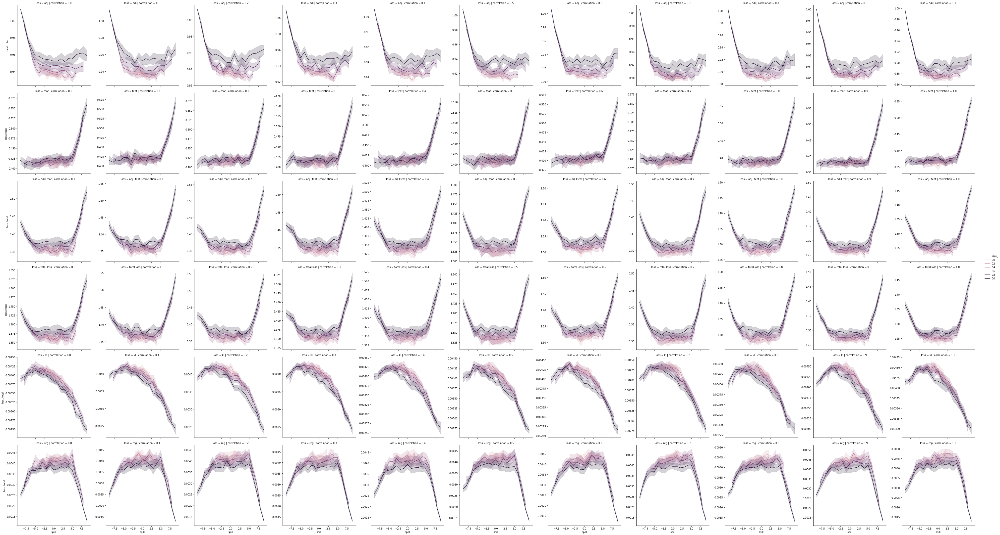

In [5]:
facet_grid = sb.relplot(x='spill', y='best total',
                        hue='dimξ', col='correlation',
                        row='loss', row_order=['adj', 'feat', 'adj+feat', 'total loss', 'kl', 'reg'],
                        data=best_total[best_total['rank'] == 5],
                        kind='line', legend='full', facet_kws={'sharey': False})

#figure_file = FIGURE_PATH.format(n_nodes=N_NODES, n_clusters=N_CLUSTERS,
#                                 n_alphas=N_ALPHAS, n_models=N_MODEL_SAMPLES, n_clusterings=N_CLUSTERINGS,
#                                 data_name='absolute_vs_spillv2adj-hue=ref_ov')
#facet_grid.fig.savefig(figure_file, bbox_inches='tight')

rank = 8

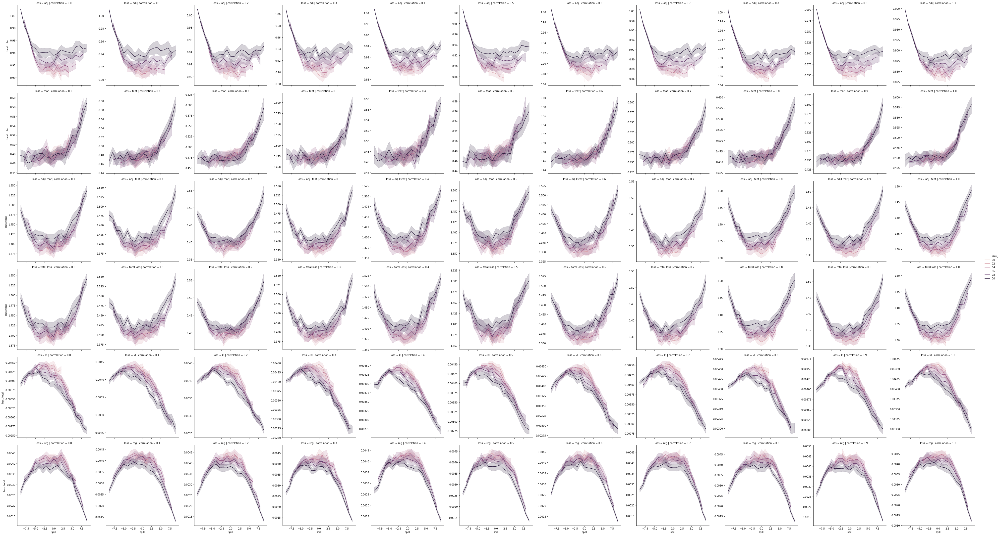

In [6]:
facet_grid = sb.relplot(x='spill', y='best total',
                        hue='dimξ', col='correlation',
                        row='loss', row_order=['adj', 'feat', 'adj+feat', 'total loss', 'kl', 'reg'],
                        data=best_total[best_total['rank'] == 8],
                        kind='line', legend='full', facet_kws={'sharey': False})

#figure_file = FIGURE_PATH.format(n_nodes=N_NODES, n_clusters=N_CLUSTERS,
#                                 n_alphas=N_ALPHAS, n_models=N_MODEL_SAMPLES, n_clusterings=N_CLUSTERINGS,
#                                 data_name='absolute_vs_spillv2adj-hue=ref_ov')
#facet_grid.fig.savefig(figure_file, bbox_inches='tight')

rank = 12

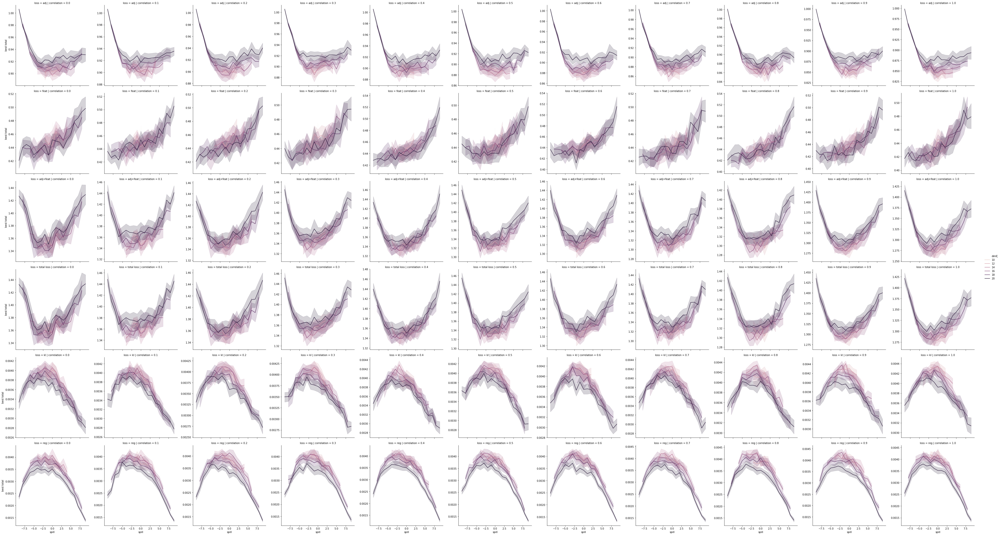

In [7]:
facet_grid = sb.relplot(x='spill', y='best total',
                        hue='dimξ', col='correlation',
                        row='loss', row_order=['adj', 'feat', 'adj+feat', 'total loss', 'kl', 'reg'],
                        data=best_total[best_total['rank'] == 12],
                        kind='line', legend='full', facet_kws={'sharey': False})

#figure_file = FIGURE_PATH.format(n_nodes=N_NODES, n_clusters=N_CLUSTERS,
#                                 n_alphas=N_ALPHAS, n_models=N_MODEL_SAMPLES, n_clusterings=N_CLUSTERINGS,
#                                 data_name='absolute_vs_spillv2adj-hue=ref_ov')
#facet_grid.fig.savefig(figure_file, bbox_inches='tight')

### Relative

rank = 5

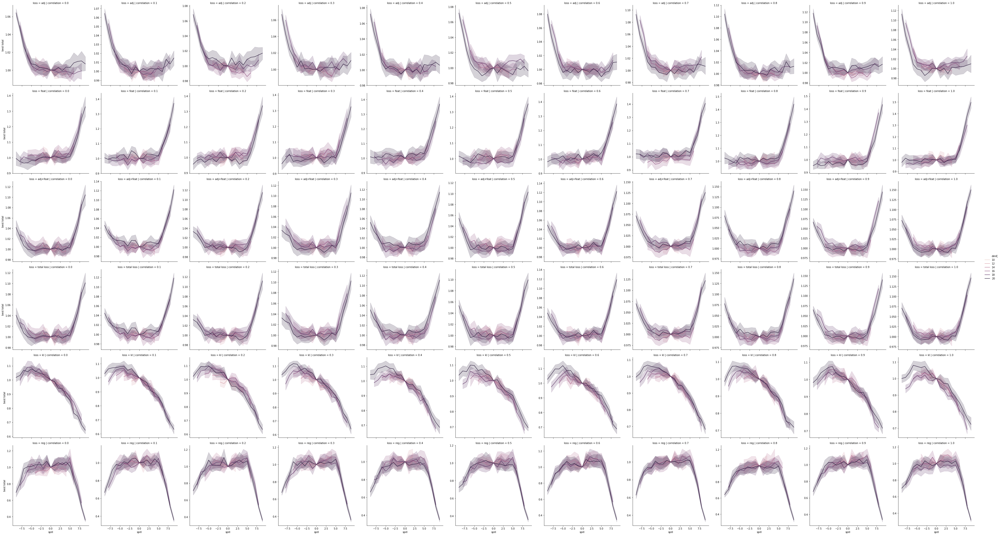

In [8]:
facet_grid = sb.relplot(x='spill', y='best total',
                        hue='dimξ', col='correlation',
                        row='loss', row_order=['adj', 'feat', 'adj+feat', 'total loss', 'kl', 'reg'],
                        data=best_total_relspill[best_total_relspill['rank'] == 5],
                        kind='line', legend='full', facet_kws={'sharey': False})

#figure_file = FIGURE_PATH.format(n_nodes=N_NODES, n_clusters=N_CLUSTERS,
#                                 n_alphas=N_ALPHAS, n_models=N_MODEL_SAMPLES, n_clusterings=N_CLUSTERINGS,
#                                 data_name='absolute_vs_spillv2adj-hue=ref_ov')
#facet_grid.fig.savefig(figure_file, bbox_inches='tight')

rank = 8

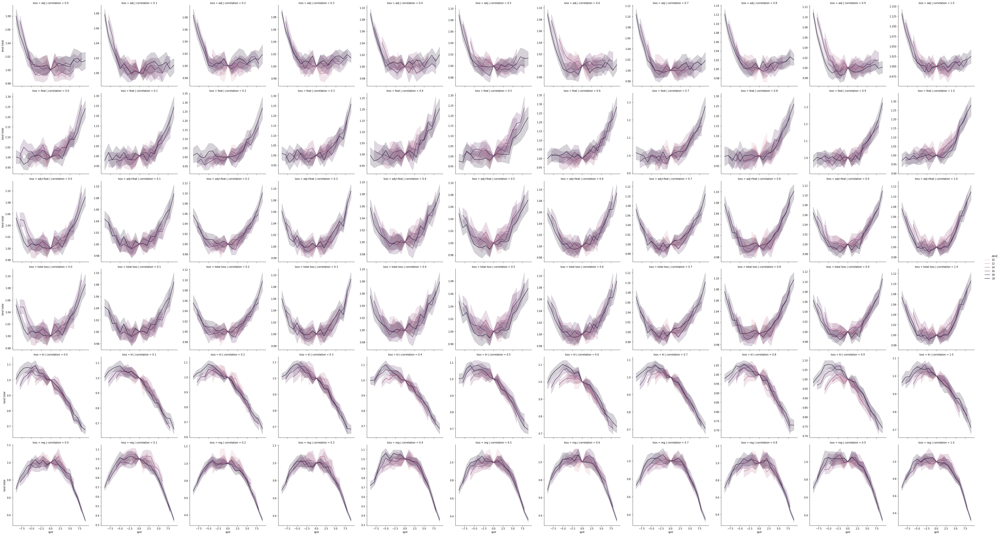

In [9]:
facet_grid = sb.relplot(x='spill', y='best total',
                        hue='dimξ', col='correlation',
                        row='loss', row_order=['adj', 'feat', 'adj+feat', 'total loss', 'kl', 'reg'],
                        data=best_total_relspill[best_total_relspill['rank'] == 8],
                        kind='line', legend='full', facet_kws={'sharey': False})

#figure_file = FIGURE_PATH.format(n_nodes=N_NODES, n_clusters=N_CLUSTERS,
#                                 n_alphas=N_ALPHAS, n_models=N_MODEL_SAMPLES, n_clusterings=N_CLUSTERINGS,
#                                 data_name='absolute_vs_spillv2adj-hue=ref_ov')
#facet_grid.fig.savefig(figure_file, bbox_inches='tight')

rank = 12

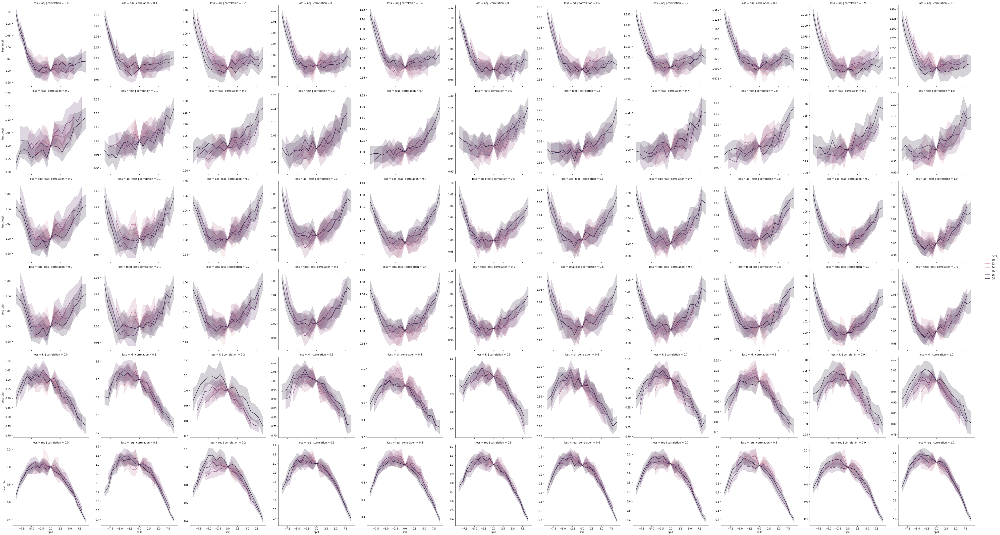

In [10]:
facet_grid = sb.relplot(x='spill', y='best total',
                        hue='dimξ', col='correlation',
                        row='loss', row_order=['adj', 'feat', 'adj+feat', 'total loss', 'kl', 'reg'],
                        data=best_total_relspill[best_total_relspill['rank'] == 12],
                        kind='line', legend='full', facet_kws={'sharey': False})

#figure_file = FIGURE_PATH.format(n_nodes=N_NODES, n_clusters=N_CLUSTERS,
#                                 n_alphas=N_ALPHAS, n_models=N_MODEL_SAMPLES, n_clusterings=N_CLUSTERINGS,
#                                 data_name='absolute_vs_spillv2adj-hue=ref_ov')
#facet_grid.fig.savefig(figure_file, bbox_inches='tight')

## columns = overlap, hue = correlation

### Absolute

rank = 5

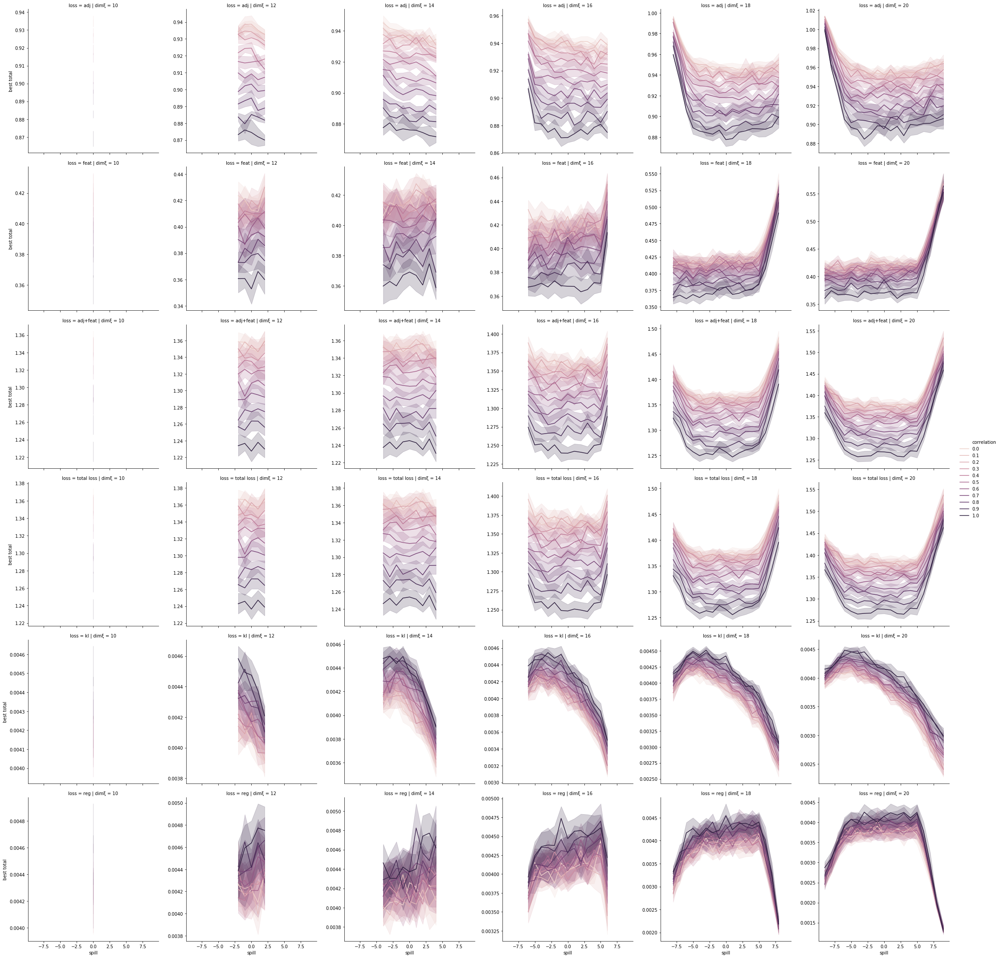

In [11]:
facet_grid = sb.relplot(x='spill', y='best total',
                        hue='correlation', col='dimξ',
                        row='loss', row_order=['adj', 'feat', 'adj+feat', 'total loss', 'kl', 'reg'],
                        data=best_total[best_total['rank'] == 5],
                        kind='line', legend='full', facet_kws={'sharey': False})

#figure_file = FIGURE_PATH.format(n_nodes=N_NODES, n_clusters=N_CLUSTERS,
#                                 n_alphas=N_ALPHAS, n_models=N_MODEL_SAMPLES, n_clusterings=N_CLUSTERINGS,
#                                 data_name='absolute_vs_spillv2adj-hue=ref_ov')
#facet_grid.fig.savefig(figure_file, bbox_inches='tight')

rank = 8

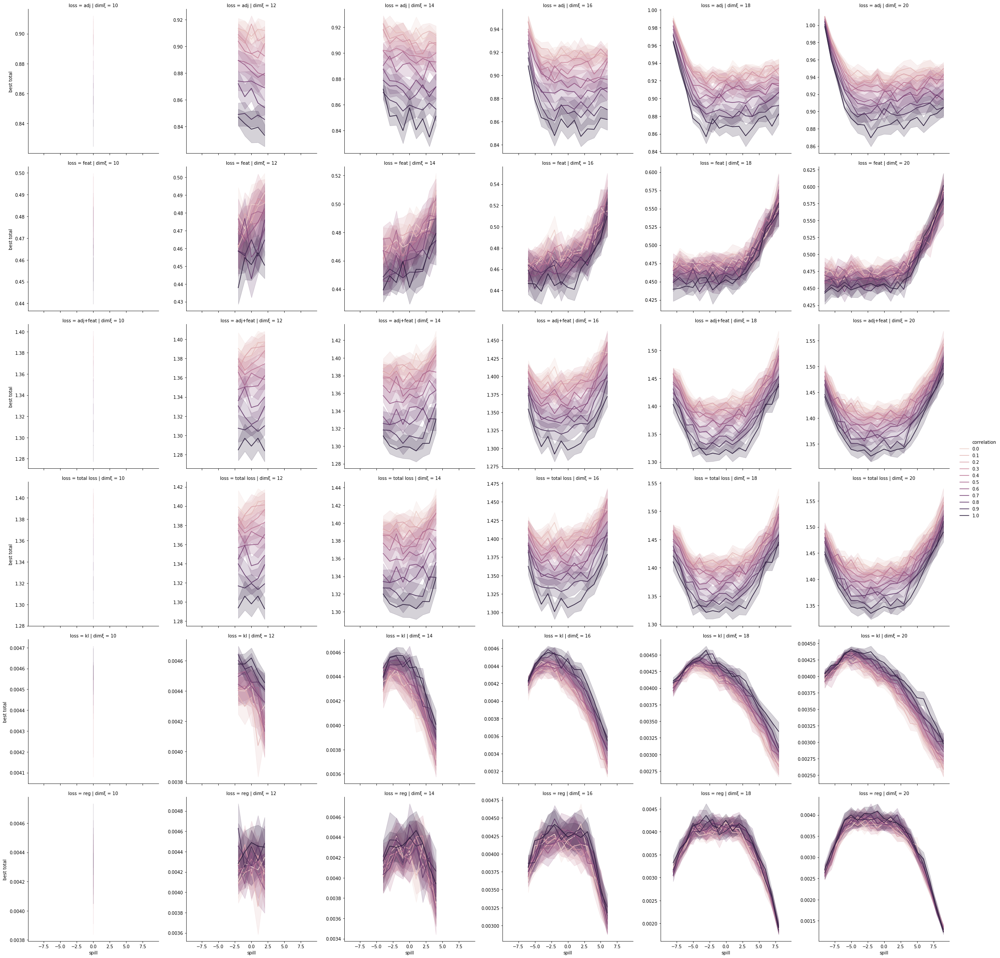

In [12]:
facet_grid = sb.relplot(x='spill', y='best total',
                        hue='correlation', col='dimξ',
                        row='loss', row_order=['adj', 'feat', 'adj+feat', 'total loss', 'kl', 'reg'],
                        data=best_total[best_total['rank'] == 8],
                        kind='line', legend='full', facet_kws={'sharey': False})

#figure_file = FIGURE_PATH.format(n_nodes=N_NODES, n_clusters=N_CLUSTERS,
#                                 n_alphas=N_ALPHAS, n_models=N_MODEL_SAMPLES, n_clusterings=N_CLUSTERINGS,
#                                 data_name='absolute_vs_spillv2adj-hue=ref_ov')
#facet_grid.fig.savefig(figure_file, bbox_inches='tight')

rank = 12

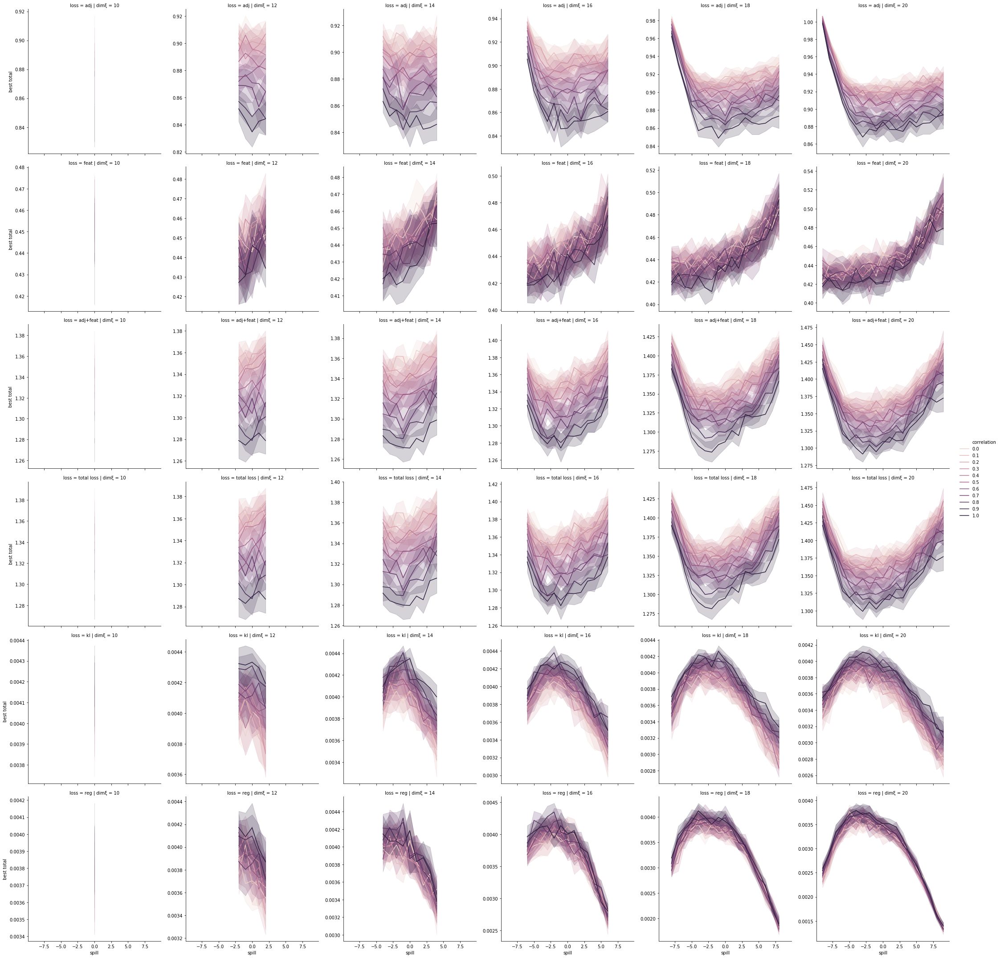

In [13]:
facet_grid = sb.relplot(x='spill', y='best total',
                        hue='correlation', col='dimξ',
                        row='loss', row_order=['adj', 'feat', 'adj+feat', 'total loss', 'kl', 'reg'],
                        data=best_total[best_total['rank'] == 12],
                        kind='line', legend='full', facet_kws={'sharey': False})

#figure_file = FIGURE_PATH.format(n_nodes=N_NODES, n_clusters=N_CLUSTERS,
#                                 n_alphas=N_ALPHAS, n_models=N_MODEL_SAMPLES, n_clusterings=N_CLUSTERINGS,
#                                 data_name='absolute_vs_spillv2adj-hue=ref_ov')
#facet_grid.fig.savefig(figure_file, bbox_inches='tight')

### Relative

rank = 5

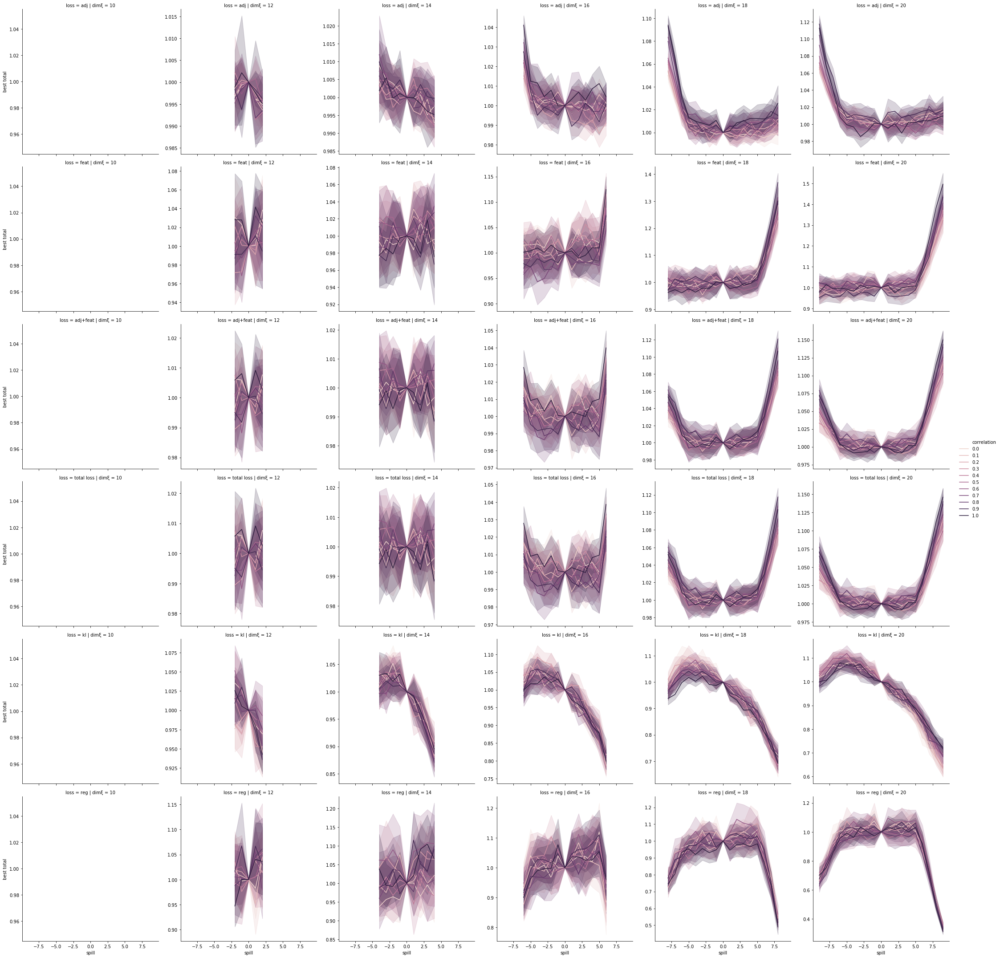

In [14]:
facet_grid = sb.relplot(x='spill', y='best total',
                        hue='correlation', col='dimξ',
                        row='loss', row_order=['adj', 'feat', 'adj+feat', 'total loss', 'kl', 'reg'],
                        data=best_total_relspill[best_total_relspill['rank'] == 5],
                        kind='line', legend='full', facet_kws={'sharey': False})

#figure_file = FIGURE_PATH.format(n_nodes=N_NODES, n_clusters=N_CLUSTERS,
#                                 n_alphas=N_ALPHAS, n_models=N_MODEL_SAMPLES, n_clusterings=N_CLUSTERINGS,
#                                 data_name='absolute_vs_spillv2adj-hue=ref_ov')
#facet_grid.fig.savefig(figure_file, bbox_inches='tight')

rank = 8

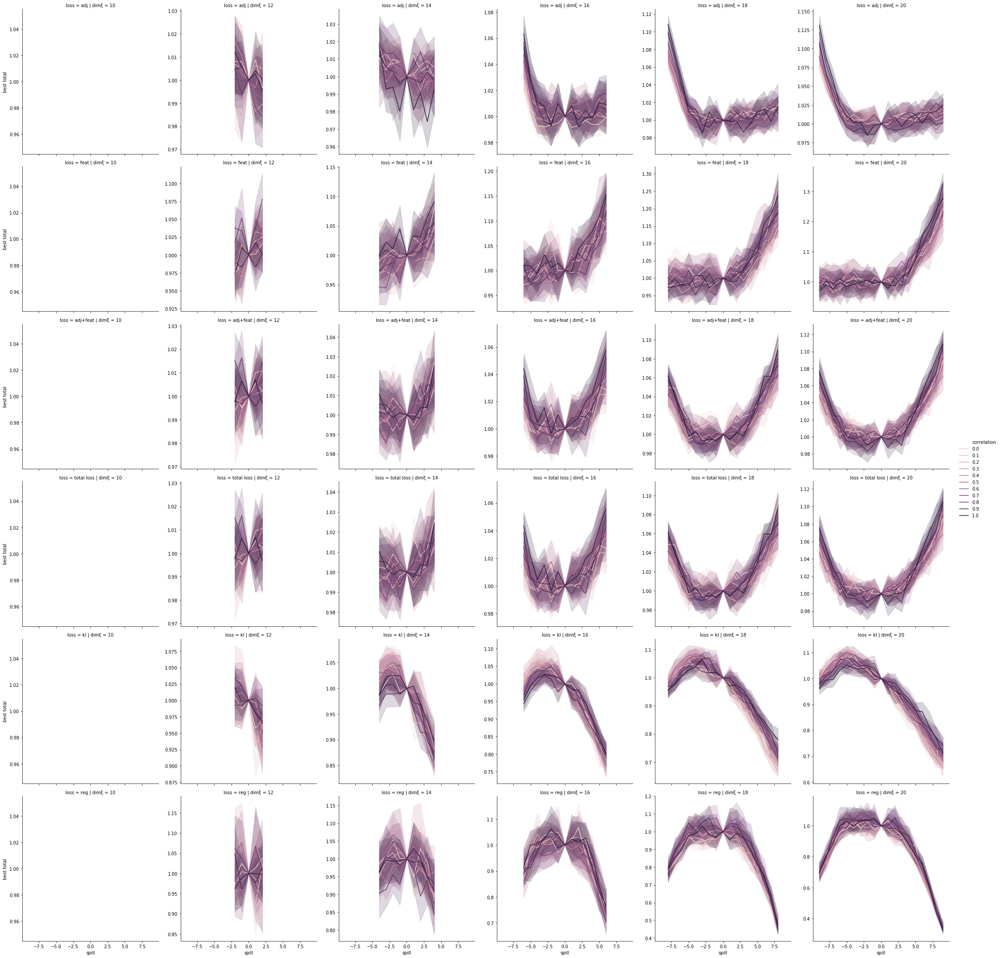

In [15]:
facet_grid = sb.relplot(x='spill', y='best total',
                        hue='correlation', col='dimξ',
                        row='loss', row_order=['adj', 'feat', 'adj+feat', 'total loss', 'kl', 'reg'],
                        data=best_total_relspill[best_total_relspill['rank'] == 8],
                        kind='line', legend='full', facet_kws={'sharey': False})

#figure_file = FIGURE_PATH.format(n_nodes=N_NODES, n_clusters=N_CLUSTERS,
#                                 n_alphas=N_ALPHAS, n_models=N_MODEL_SAMPLES, n_clusterings=N_CLUSTERINGS,
#                                 data_name='absolute_vs_spillv2adj-hue=ref_ov')
#facet_grid.fig.savefig(figure_file, bbox_inches='tight')

rank = 12

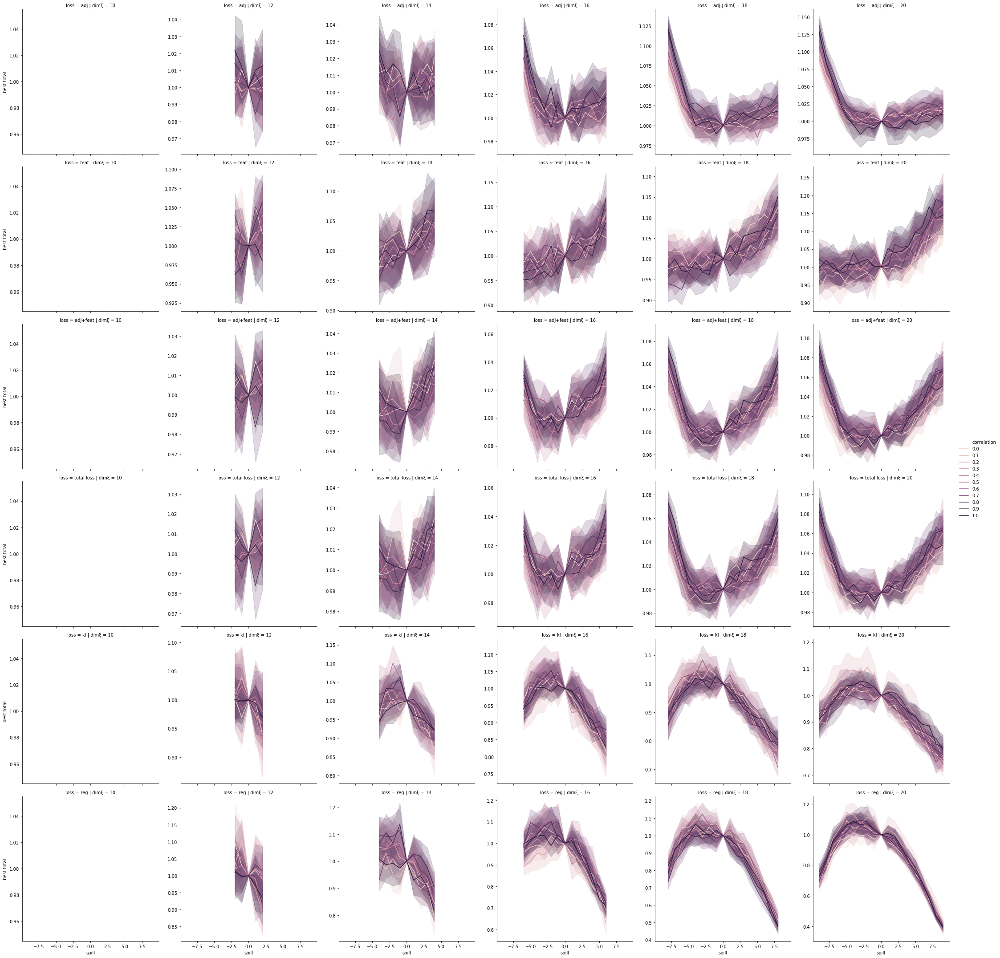

In [16]:
facet_grid = sb.relplot(x='spill', y='best total',
                        hue='correlation', col='dimξ',
                        row='loss', row_order=['adj', 'feat', 'adj+feat', 'total loss', 'kl', 'reg'],
                        data=best_total_relspill[best_total_relspill['rank'] == 12],
                        kind='line', legend='full', facet_kws={'sharey': False})

#figure_file = FIGURE_PATH.format(n_nodes=N_NODES, n_clusters=N_CLUSTERS,
#                                 n_alphas=N_ALPHAS, n_models=N_MODEL_SAMPLES, n_clusterings=N_CLUSTERINGS,
#                                 data_name='absolute_vs_spillv2adj-hue=ref_ov')
#facet_grid.fig.savefig(figure_file, bbox_inches='tight')